In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression

In [2]:
fx_london_fix = pd.read_excel(r'C:\Users\aadit\Downloads\bsic_systematic_fx-main\data\fixes\fx_fixes.xlsx', sheet_name='LON_Fix', index_col=0, parse_dates=True)
fx_london_fix =  fx_london_fix.fillna(fx_london_fix.mean())
fx_ny_fix = pd.read_excel(r'C:\Users\aadit\Downloads\bsic_systematic_fx-main\data\fixes\fx_fixes.xlsx', sheet_name='NY_Fix', index_col=0, parse_dates=True)
fx_ny_fix =  fx_ny_fix.fillna(fx_ny_fix.mean())
fx_london_fix.columns = [col.split()[0] for col in fx_london_fix.columns]
fx_ny_fix.columns = [col.split()[0] for col in fx_ny_fix.columns]

In [3]:
#US is the domestic currency so always must be in the denominator
def convert_fx(df: pd.DataFrame):
    new_df = df.copy()
    for col in df.columns: 
        if col[:3] == 'USD': 
            new_df[col[3:] + 'USD'] = 1/df[col]
            new_df.drop(col, axis=1, inplace=True)
            
    return new_df
fx_london_fix = convert_fx(fx_london_fix)
fx_ny_fix = convert_fx(fx_ny_fix) 

countries_to_fx = {
    'AD': 'AUDUSD',
    'CD': 'CADUSD', 
    'SF': 'CHFUSD', 
    'DK': 'DKKUSD',
    'EU': 'EURUSD',
    'BP': 'GBPUSD',
    'JY': 'JPYUSD',
    'NK': 'NOKUSD', 
    'ND': 'NZDUSD',
    'SK': 'SEKUSD',
    'US': 'USD',
}

fx = [fx_london_fix, fx_ny_fix] 

# Iterate over each DataFrame
for df in fx: 
    # Sort the DataFrame by 'Date' column in ascending order
    df.sort_values(by='Date', ascending=True, inplace=True) 
    
    # Iterate over each column in the DataFrame
    for col in df.columns: 
        # Calculate the returns for the last 365 days and create a new column
        df[f'{col}_returns'] = df[col].pct_change(periods=1)#daily


In [4]:
swaps_london_fix = pd.read_excel(r'C:\Users\aadit\Downloads\bsic_systematic_fx-main\data\fixes\swaps_fixes.xlsx', sheet_name='LON_Fix', index_col=0, parse_dates=True)
swaps_london_fix = swaps_london_fix.div(100)
swaps_london_fix =  swaps_london_fix.fillna(swaps_london_fix.mean())
swaps_ny_fix = pd.read_excel(r'C:\Users\aadit\Downloads\bsic_systematic_fx-main\data\fixes\swaps_fixes.xlsx', sheet_name='NY_Fix', index_col=0, parse_dates=True)
swaps_ny_fix = swaps_ny_fix.div(100)
swaps_ny_fix =  swaps_ny_fix.fillna(swaps_ny_fix.mean())

swaps_london_fix.columns = [countries_to_fx[col.split()[0][:2]] for col in swaps_london_fix.columns]
swaps_ny_fix.columns = [countries_to_fx[col.split()[0][:2]] for col in swaps_ny_fix.columns]


In [5]:
int_rates = [swaps_london_fix,swaps_ny_fix]
for df in int_rates: 
    # Sort the DataFrame by 'Date' column in ascending order
    df.sort_values(by='Date', ascending=True, inplace=True) 
    # Iterate over each column in the DataFrame
    for col in df.columns: 
        df[f'{col}_differential'] = (((df[col])+1)/((df['USD']) + 1))-1

In [6]:
dfs = (fx_london_fix,fx_ny_fix,swaps_london_fix,swaps_ny_fix)
def drop_rows(df):
    df.drop(df.index[:100], inplace=True)

for df in dfs:
    drop_rows(df)

Create a return column, interest rate differentional, regress return on int rate diff, then try lagging int rate diff and rturn

AUDUSD
Coefficients: [0.00923022]
Intercept: -9.300148269560091e-05
R-squared: 0.0003590135551362339


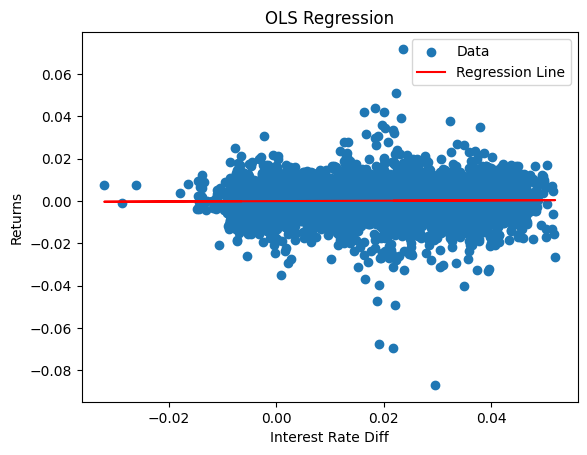

DKKUSD
Coefficients: [0.00279694]
Intercept: 5.735570548509891e-05
R-squared: 3.3353936022884056e-05


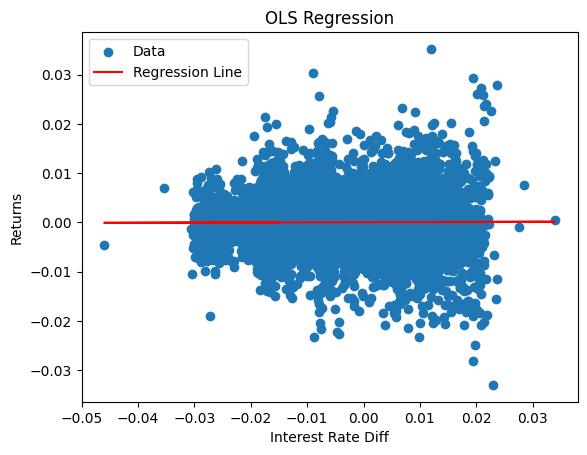

EURUSD
Coefficients: [0.00648361]
Intercept: 8.065930017710239e-05
R-squared: 0.0001700085070711621


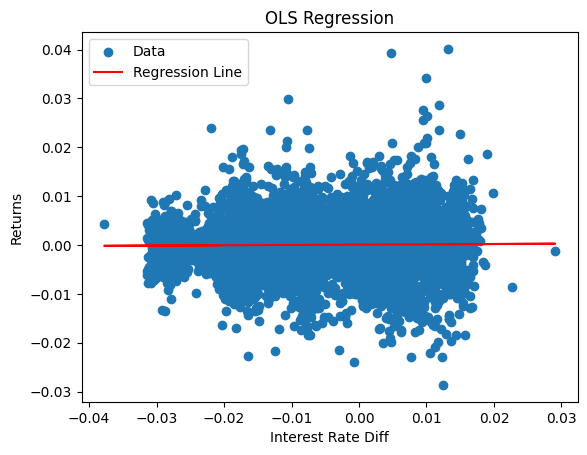

GBPUSD
Coefficients: [0.00343372]
Intercept: -2.3287611629977648e-05
R-squared: 4.12981008144353e-05


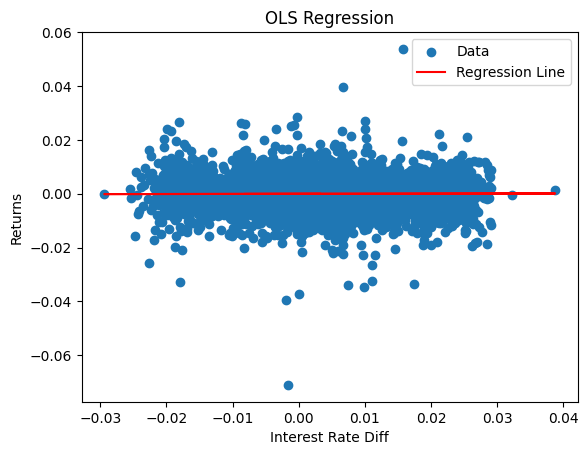

NZDUSD
Coefficients: [0.00814141]
Intercept: -8.29086310063486e-05
R-squared: 0.00022165157606035546


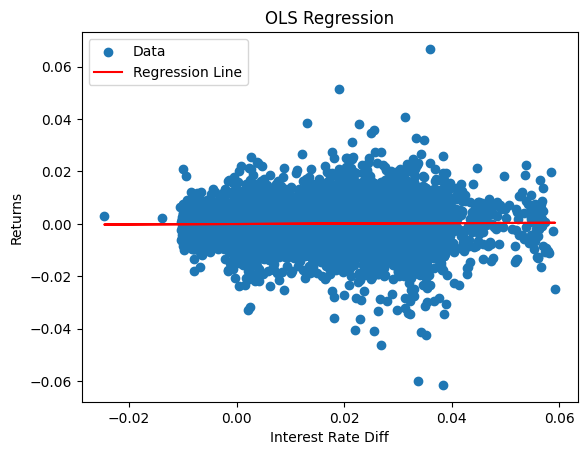

CADUSD
Coefficients: [0.00448577]
Intercept: 1.9078302791400374e-05
R-squared: 3.631008920057521e-05


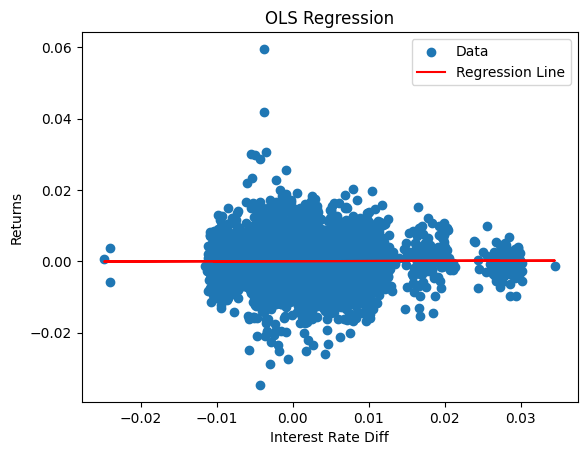

CHFUSD
Coefficients: [0.00770454]
Intercept: 0.00024359707198586786
R-squared: 0.00015342289679398657


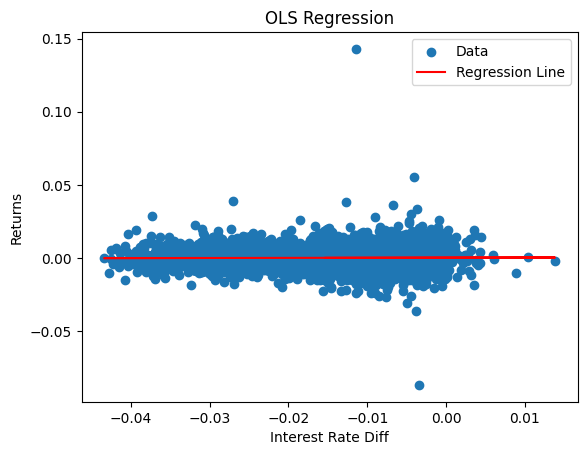

JPYUSD
Coefficients: [0.00494412]
Intercept: 5.772983894720407e-05
R-squared: 0.00015653371160340157


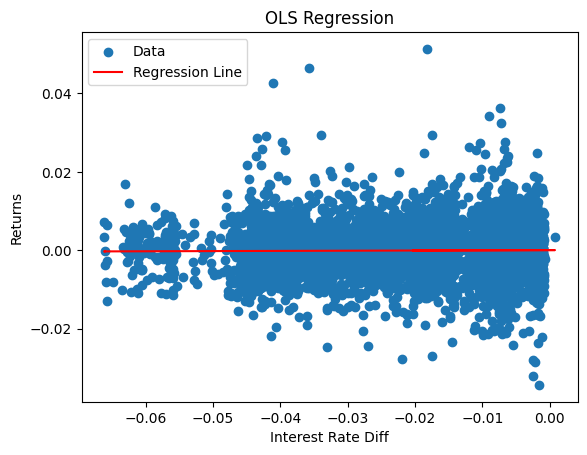

NOKUSD
Coefficients: [0.00651821]
Intercept: -5.5369449255844926e-05
R-squared: 0.00015238956746443932


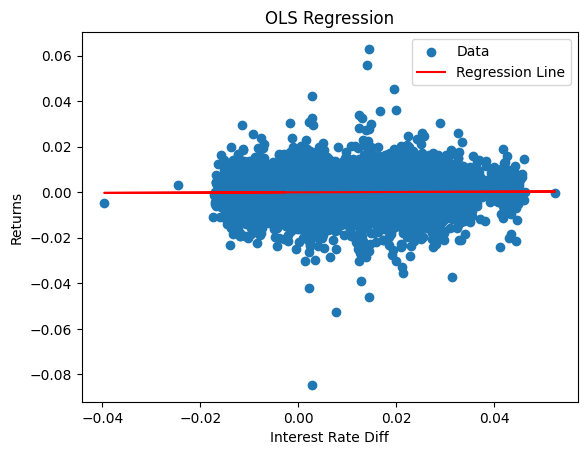

SEKUSD
Coefficients: [0.0117449]
Intercept: 2.731105205923892e-05
R-squared: 0.00051163296832335


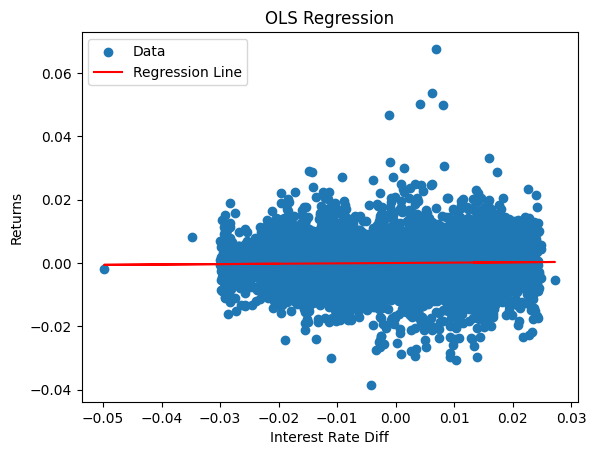

AUDUSD
Coefficients: [0.00989261]
Intercept: -0.00010271467839776687
R-squared: 0.0004010030810444043


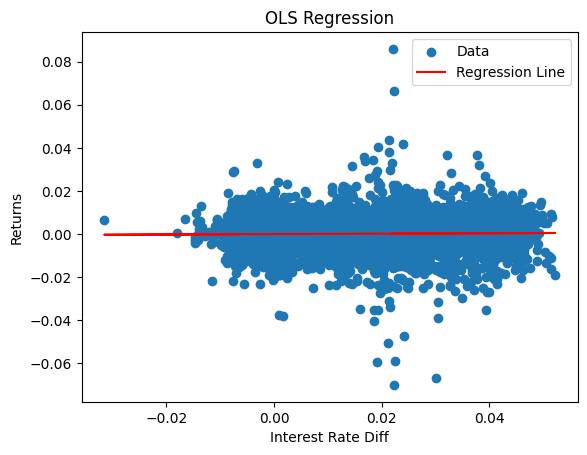

EURUSD
Coefficients: [0.00748883]
Intercept: 8.622768985899388e-05
R-squared: 0.0002154744449954782


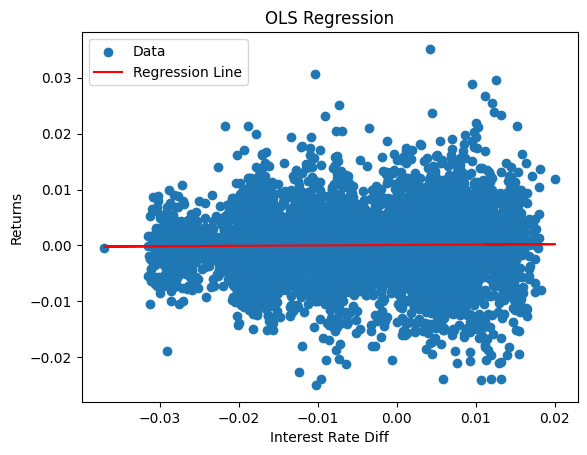

GBPUSD
Coefficients: [0.0032694]
Intercept: -2.2893739268201457e-05
R-squared: 3.747927067121459e-05


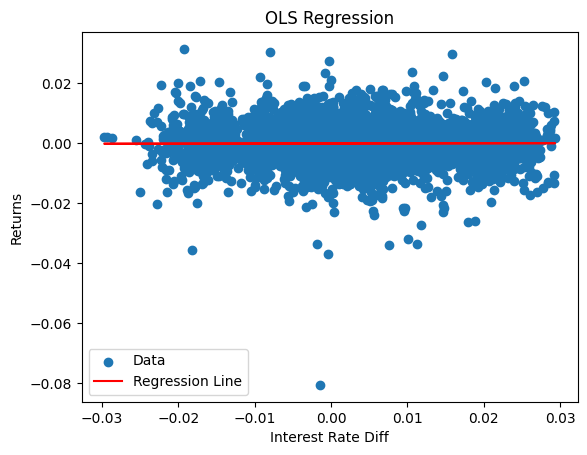

NZDUSD
Coefficients: [0.00841333]
Intercept: -8.929847206747334e-05
R-squared: 0.0002417266751110203


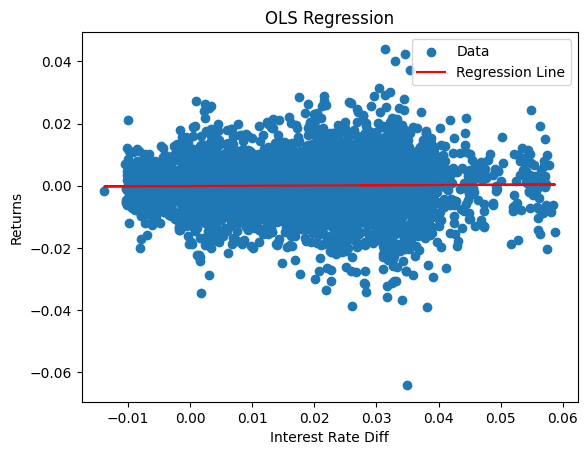

CADUSD
Coefficients: [0.00526105]
Intercept: 1.800094065147529e-05
R-squared: 4.825811995257112e-05


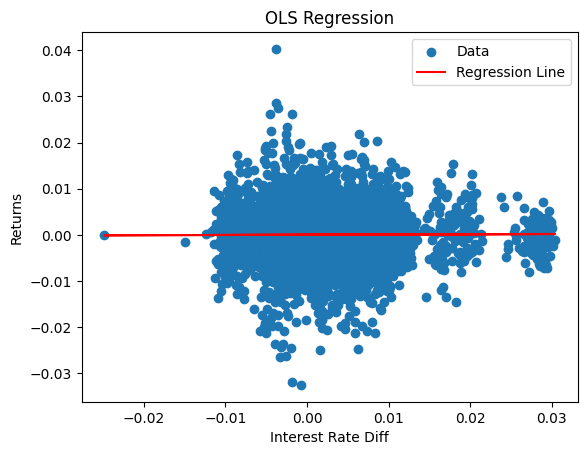

CHFUSD
Coefficients: [0.00935779]
Intercept: 0.0002700519532411971
R-squared: 0.00020307059424418128


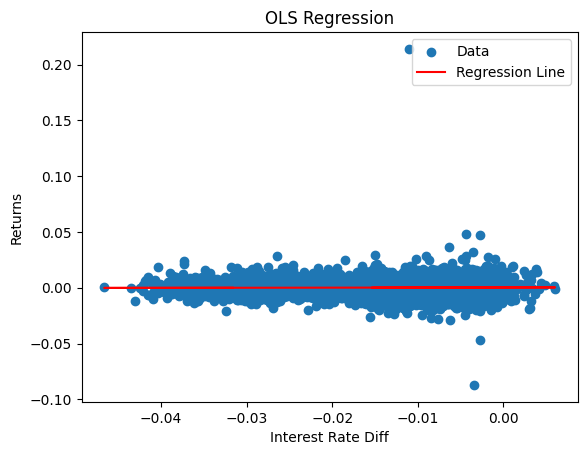

DKKUSD
Coefficients: [0.00694998]
Intercept: 6.708680877149662e-05
R-squared: 0.00020916091091160993


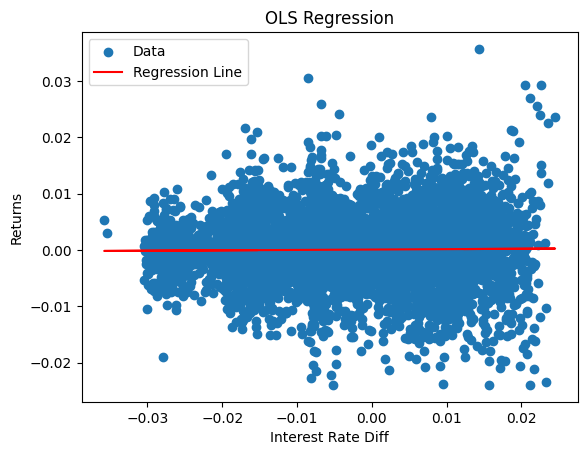

JPYUSD
Coefficients: [0.00515196]
Intercept: 6.235683253842105e-05
R-squared: 0.00016842003877814982


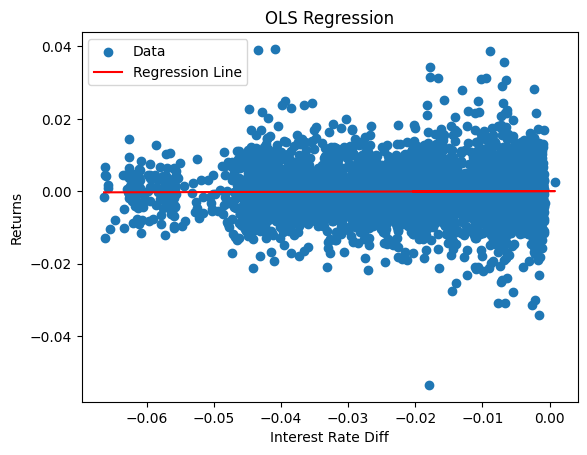

NOKUSD
Coefficients: [0.00652729]
Intercept: -5.5102725920946864e-05
R-squared: 0.00015023171469064067


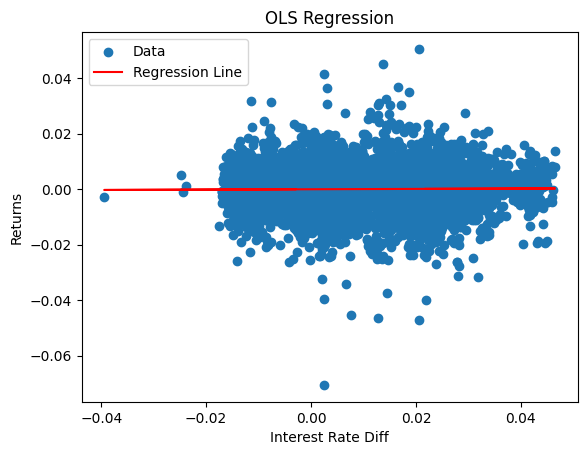

SEKUSD
Coefficients: [0.0117179]
Intercept: 2.800273250452898e-05
R-squared: 0.0004938266677095848


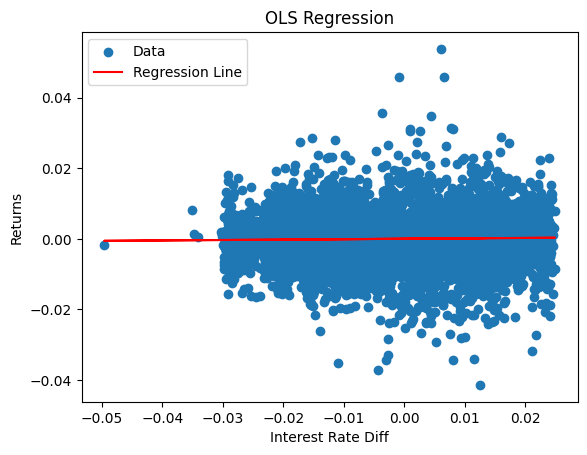

In [7]:
def perform_ols_regression(X, Y):
    # Reshape X and Y if they are 1D arrays
    X = np.atleast_2d(X).T
    Y = np.atleast_2d(Y).T

    # Create and fit the linear regression model
    model = LinearRegression().fit(X, Y)

    # Get the coefficients and intercept
    coefficients = model.coef_[0]
    intercept = model.intercept_[0]

    # Print the summary
    print(f"Coefficients: {coefficients}")
    print(f"Intercept: {intercept}")
    print(f"R-squared: {model.score(X, Y)}")

    # Plot the data and the regression line
    plt.scatter(X, Y, label="Data")
    plt.plot(X, model.predict(X), color="red", label="Regression Line")
    plt.xlabel(f'Interest Rate Diff')
    plt.ylabel("Returns")
    plt.title("OLS Regression")
    plt.legend()
    plt.show()
for i, j in zip(fx, int_rates):
    for currency_pair in i.columns[:-10]:
        print(currency_pair)
        returns_column = f"{currency_pair}_returns"
        differential_column = f"{currency_pair}_differential"
        
        if returns_column in i.columns and differential_column in j.columns:
            returns = i[returns_column]
            interest_rate_diff = j[differential_column]
        
            # Call the OLS regression function
            perform_ols_regression(interest_rate_diff, returns)
        else:
            print(f"Columns not found for currency pair: {currency_pair}")


To DO: construct signal
try to construct trading logic

Read Abt modern portfolio theory - how are we weighting currencies(advanced model)
Learn about factor covariance matrix
Py port opt - portfolio opt package

In [8]:
def signal_construct(nyc_int, london_int, ny_fx, london_fx, MA):
    currencies = list(countries_to_fx.values())  # Extracting currency names from the columns of ny_fx
    portfolio = {cur: 0 for cur in currencies}  # Initializing signal for each currency
    differential_windows = {cur_pair: [] for cur_pair in [(c1, c2) for c1 in currencies for c2 in currencies if c1 != c2]}

    for (london_index, london_row), (nyc_index, nyc_row) in zip(london_int.iterrows(), nyc_int.iterrows()):
        # London rebalance
        for country1 in currencies:
            for country2 in currencies:
                if country1 != country2:
                    london_differential = london_row[f"{country1}_differential"] - london_row[f"{country2}_differential"]
                    differential_windows[(country1, country2)].append(london_differential)
                    if len(differential_windows[(country1, country2)]) > MA:
                        differential_windows[(country1, country2)].pop(0)  # Remove the oldest differential
                    if len(differential_windows[(country1, country2)]) >= MA:
                        ma = np.mean(differential_windows[(country1, country2)])
                        subsignal = (london_differential - ma) / abs(ma)
                        if country1 != 'USD':
                            portfolio[country1] += subsignal 
                        if country2 != 'USD':
                            portfolio[country2] -= subsignal

    return portfolio

# Example usage:
signal_construct(swaps_ny_fix, swaps_london_fix, fx_ny_fix, fx_london_fix, 15)


{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0, 'CADUSD': 0, 'CHFUSD': 0, 'DKKUSD': 0, 'EURUSD': 0, 'GBPUSD': 0, 'JPYUSD': 0, 'NOKUSD': 0, 'NZDUSD': 0, 'SEKUSD': 0, 'USD': 0}
{'AUDUSD': 0,

{'AUDUSD': 13272.4972741512,
 'CADUSD': 4836.090621503808,
 'CHFUSD': 7959.465078707771,
 'DKKUSD': 11276.194620972281,
 'EURUSD': -23284.644511200004,
 'GBPUSD': -4072.065211322429,
 'JPYUSD': 1330.3355464314338,
 'NOKUSD': -3565.223085054734,
 'NZDUSD': -3035.723492551483,
 'SEKUSD': 4490.180257079847,
 'USD': 0}

RUn regression with signals as x variables, returns as y - all currecnies pooled(panel reg)
This is to get factor returns(shared for all cur in a point in time)
Beta of this reg is the factor returns used in the next reg
To backtest :
Need to run multiple iterations(daily, by iterating through the rows)
This is all to backtest
Use zipline package, or their backtester(check backtester.py for compute positions and compute pnl)
FUnctions: Compute position, compute pnl, compute stats

Then, to get factor loading, run regression for each cur, seperately, in a time series reg
y = currency returns
x = factor returns ()
Beta of this reg is the factor loading in our final factor model